In [179]:
import os
import sys
from pathlib import Path

import h5py
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import skimage
from joblib import Parallel, delayed
from skimage import exposure, io
from skimage.util import img_as_ubyte
from tqdm.notebook import tqdm, trange
import cv2


In [180]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / "data"
match_info_dir = data_dir / "match"

In [181]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils
import transform

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Import IMC data 

In [182]:
from skimage.transform import rotate
from functools import partial

h5_data_dir = p_dir / "data" / "h5"

def joblib_loop(task, pics):
    return Parallel(n_jobs=20)(delayed(task)(i) for i in pics)

def get_imgs(experiment, name):
    with h5py.File(h5_data_dir / f"{experiment}.hdf5", "r") as f:
        imgs = f[name][:]
        labels = list(f[name].attrs["markers"])
    return imgs, labels


def contrast_stretching(img):
    # Contrast stretching
    p2, p98 = np.percentile(img, (5, 90))
    img_rescale = exposure.rescale_intensity(
        img, in_range=(p2, p98), out_range=(0, 255)
    ).astype(np.uint8)
    return img_rescale

def crop_img(img, info):
    # Rotate img
    y, h_region, x, w_region = info["bbox"]
    rotation = info["rotation_init"]
    rotation_small = info["rotation_adjust"]
    border = info["border"]

    img = rotate(img, rotation, resize=True)
    img = cv2.copyMakeBorder(
        img, border, border, border, border, cv2.BORDER_CONSTANT, None, value=0
    )
        
    # Get region for img
    if "img_region" in info.keys():
        row_min, row_max, col_min, col_max = info["img_region"]
        img = img[row_min:row_max, col_min:col_max]
        img = rotate(img, rotation_small, resize=True)
        
    if "affine" in info.keys():
        aff = info["affine"]
        pad = info["pad"]
        y = y - pad
        h_region = h_region + 2*pad
        x = x - pad
        w_region = w_region + 2*pad
        y = 0 if y < 0 else y
        x = 0 if x < 0 else x
        img_aff = img[y : y + h_region, x : x + w_region]
        img = transform.apply_global_affine(img_aff, img_aff, aff)
        y, h_region, x, w_region = info["bbox_aff"]
        
    img = img[y : y + h_region, x : x + w_region]
    img = contrast_stretching(img)
    img = img_as_ubyte(img)
    return img


In [183]:
experiment = "tonsil"
core = "DonorE"
datasets = [
    core + "_1",
    core + "_2",
    core + "_3",
    core + "_4",
    core + "_5",
    core + "_6",
]
# datasets = [
#     core + "_4",
# ]


imgs, markers = get_imgs(f"{experiment} {core}", "IMC")

In [184]:
# experiment = "Lung"
# core = "B5"
# datasets = [
#     core + "_1",
#     core + "_2",
#     core + "_3",
#     core + "_4",
# ]

# imgs, markers = get_imgs(f"{experiment} {core}", "IMC")

In [185]:
# import napari

# napari.view_image(np.stack(imgs), name=markers, channel_axis=0, visible=False)

In [186]:
# subset_lung = ["HistoneH3"]
# subset_tonsil = ["DNA1", "DNA2", 'Ki67', 'CD21', 'COL1', 'CD38', 'Vimentin', 'CD20', 'H3K27me3', 'PD1']
subset_tonsil = ["DNA1", "DNA2", 'H3K27me3', 'Ki67', 'PD1']

img_dapi = np.max(contrast_stretching(imgs[[markers.index(marker) for marker in subset_tonsil]]), axis=0)
img_dapi = contrast_stretching(img_dapi)

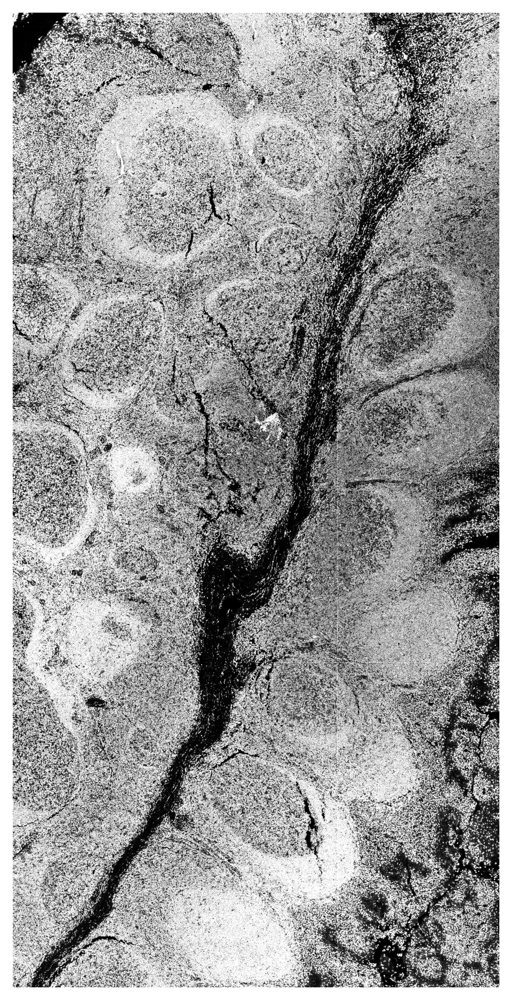

In [187]:
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(img_dapi, cmap="gray")
ax.axis("off")
plt.show()

In [188]:
imgs_dapi = []
imgs_cropped = []
for dataset in datasets:
    try:
        info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
    except:
        continue
    img = crop_img(img_dapi, info)
    imgs_dapi.append(img)
    
    func = partial(crop_img, info=info)
    img_cr = joblib_loop(func, imgs)
    imgs_cropped.append(img_cr)

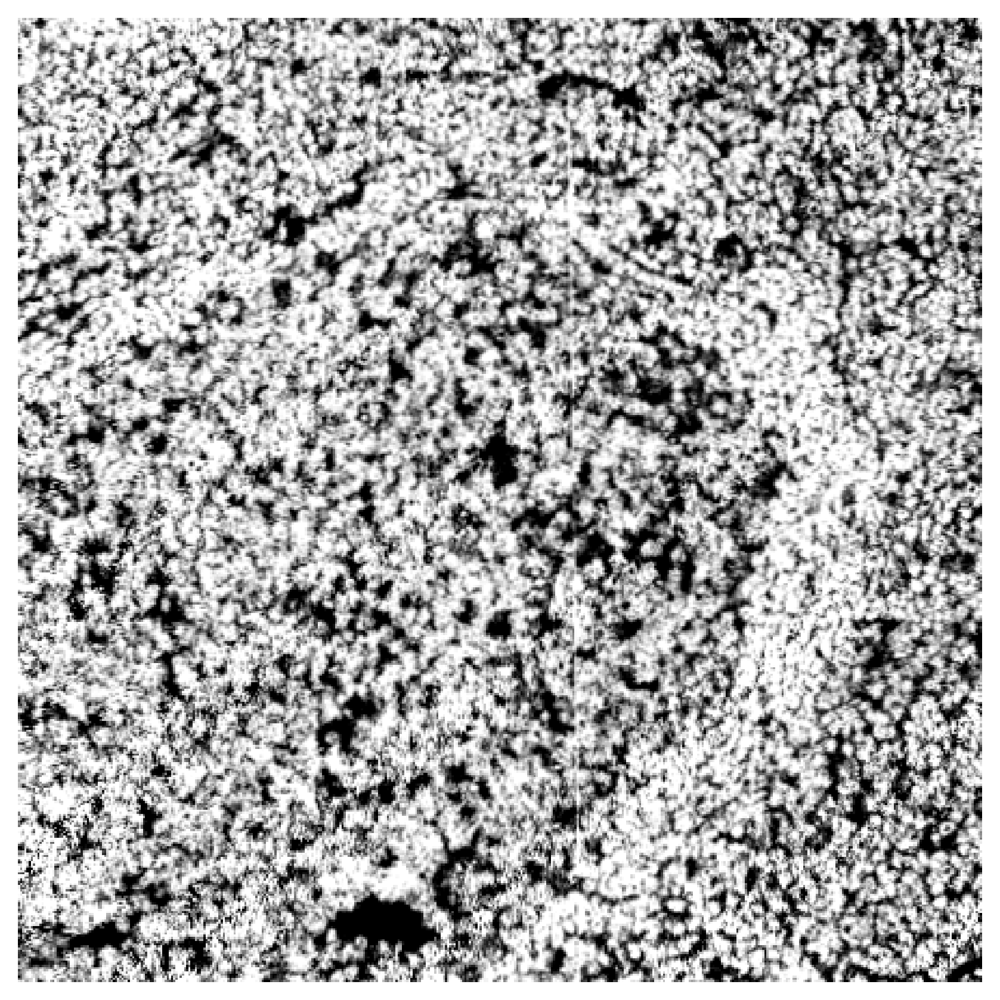

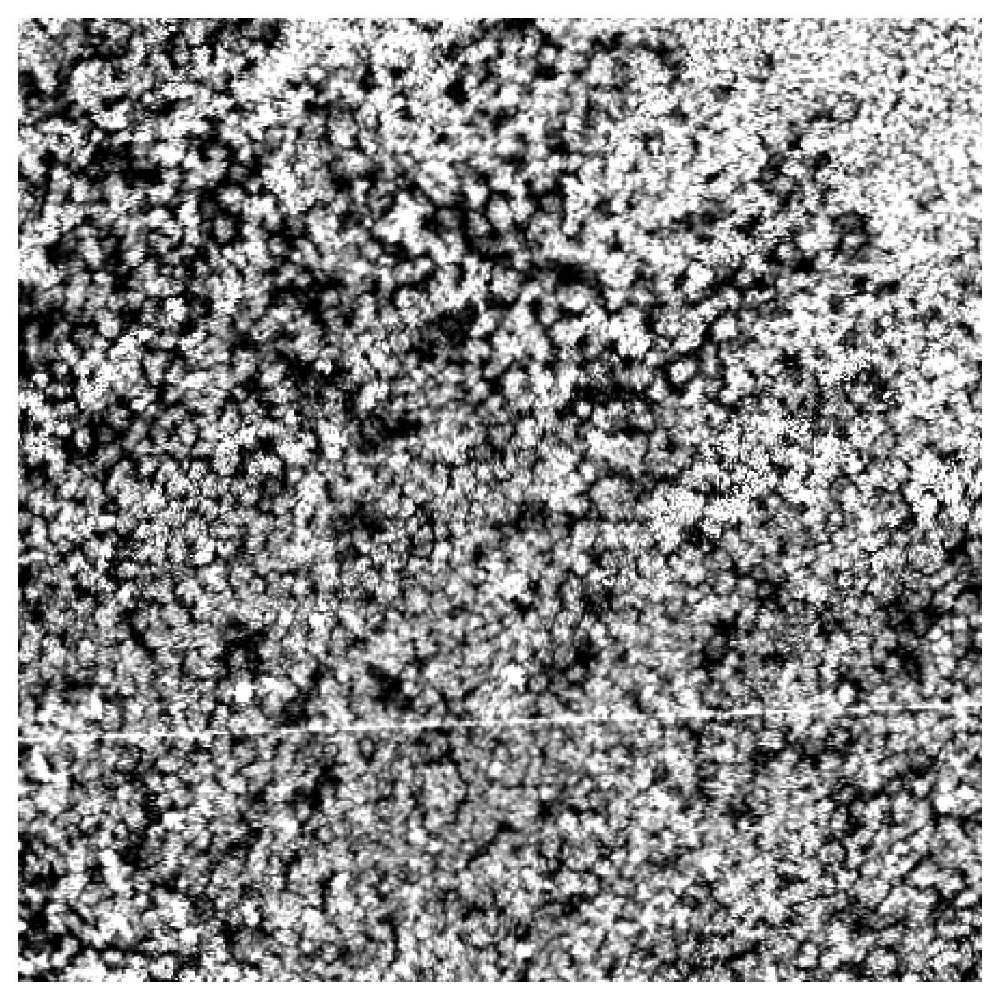

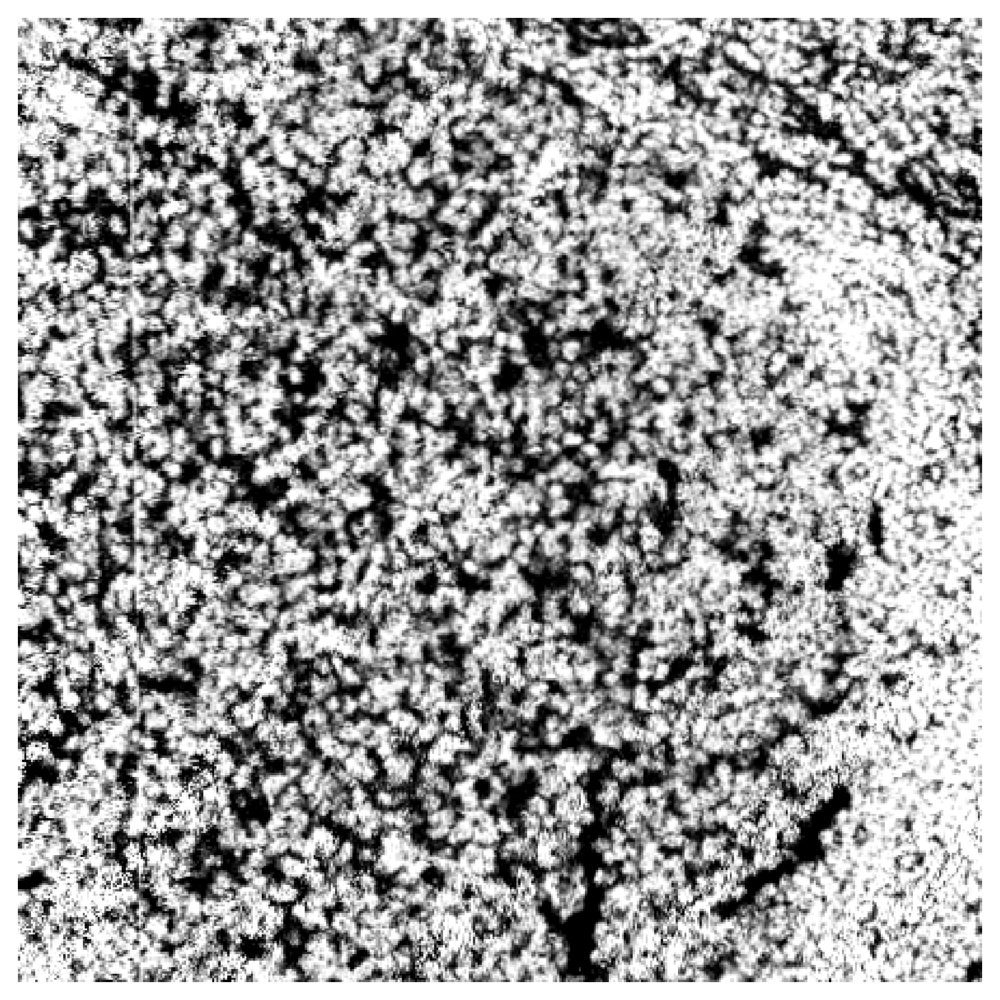

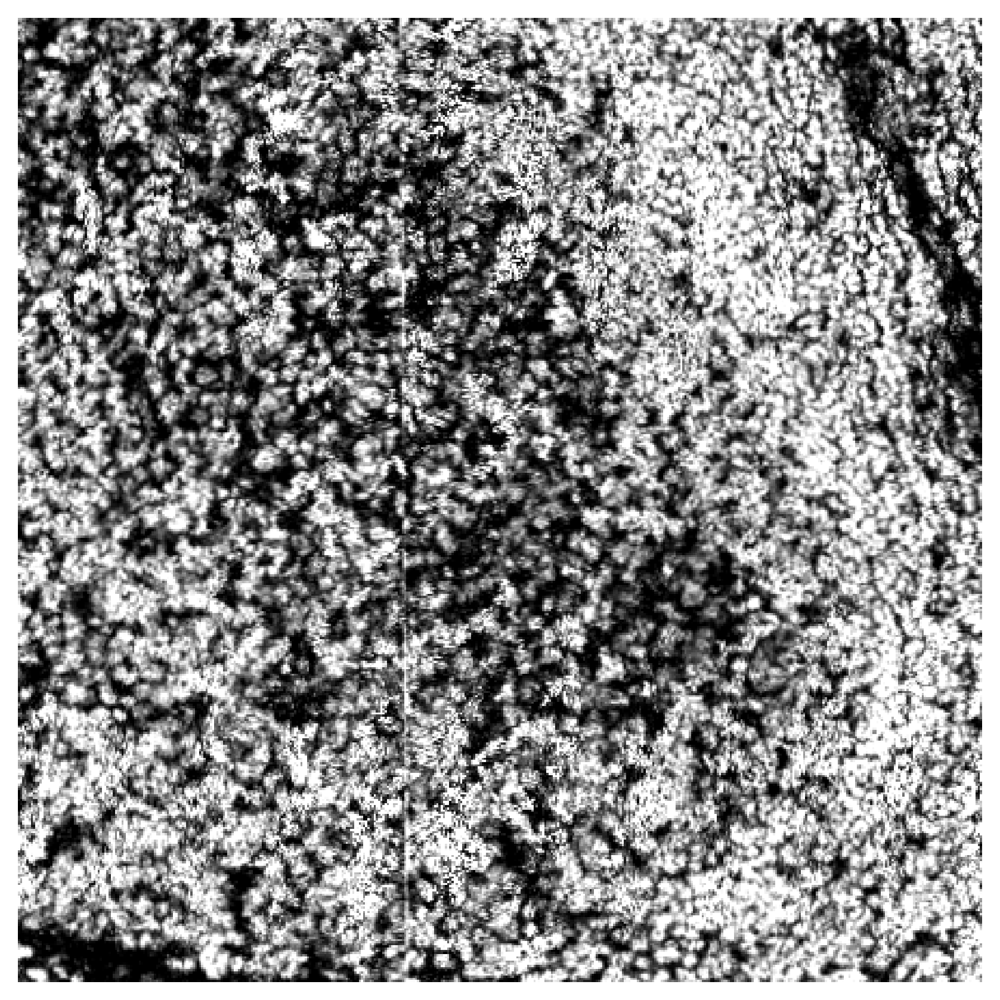

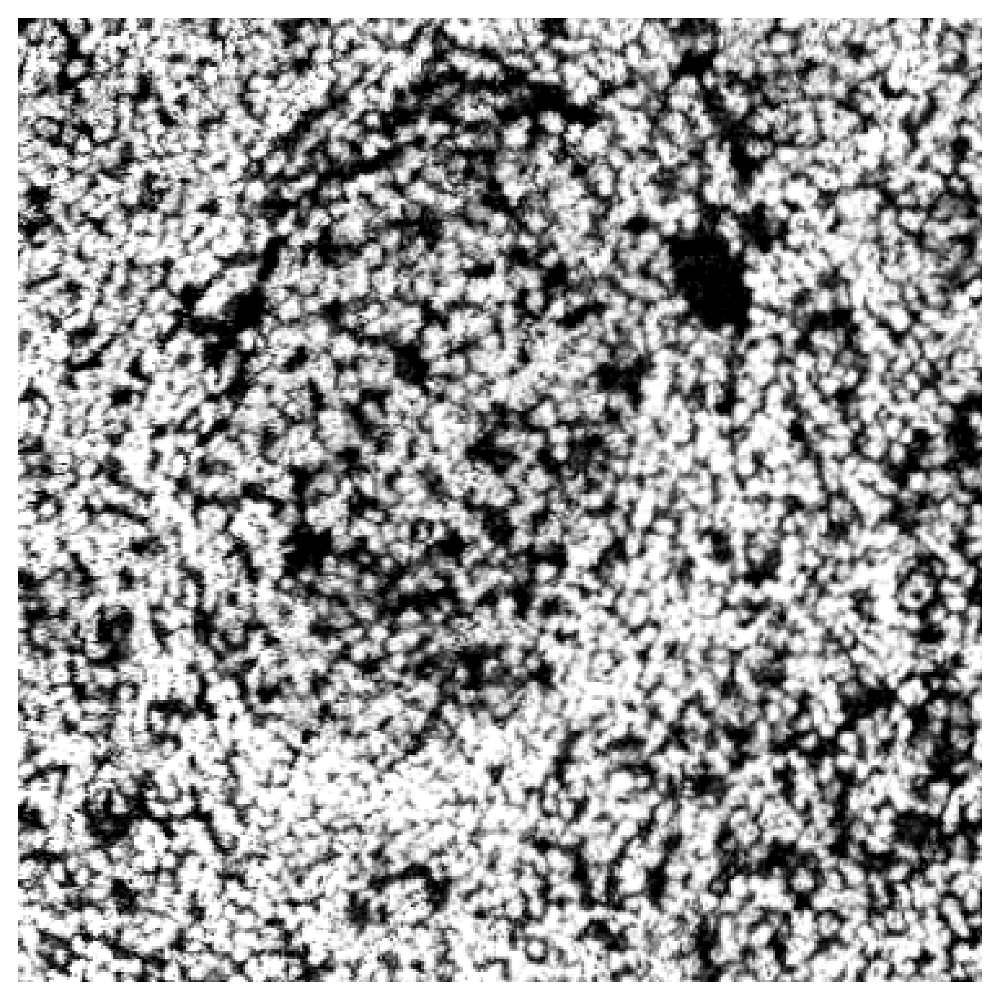

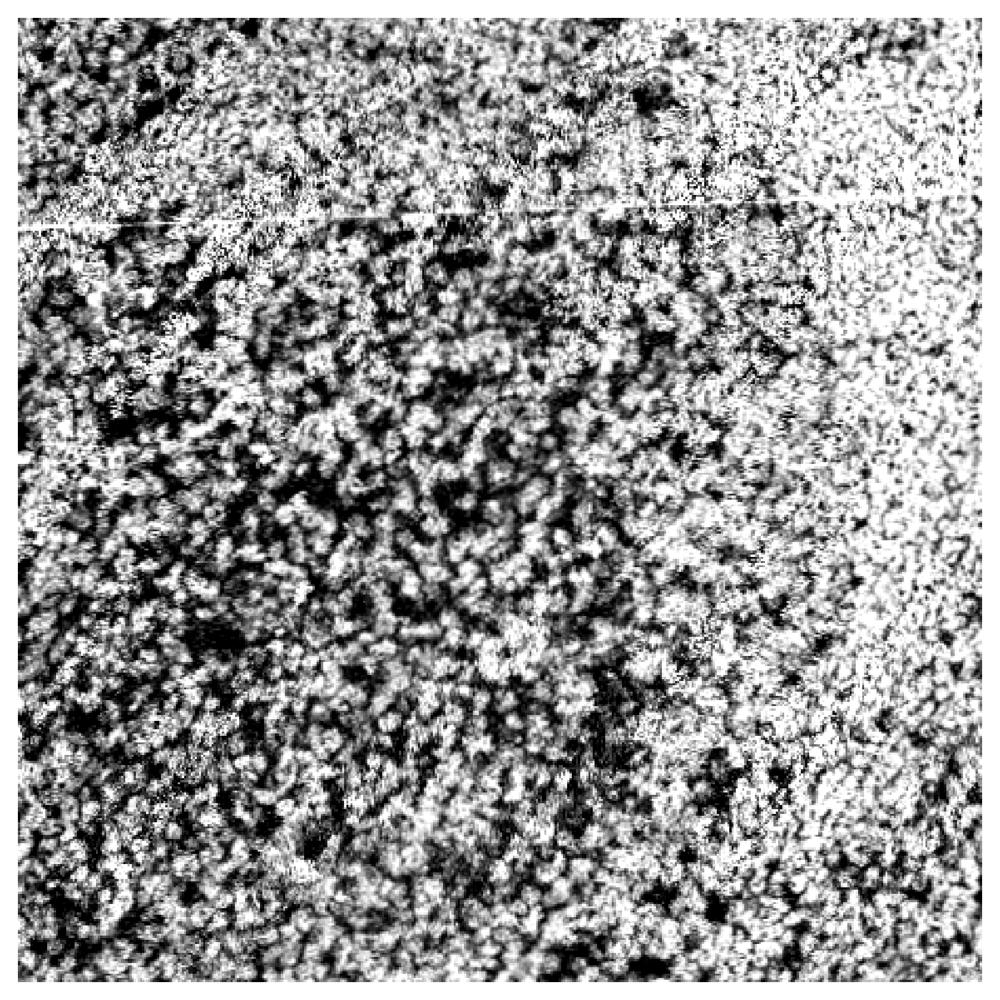

In [189]:
for img in imgs_dapi:
    fig, ax = plt.subplots(figsize=(7, 7))
    ax.imshow(img, cmap="gray")
    ax.axis("off")
    plt.show()

# Import SIMS data

In [190]:
from skimage.transform import resize
from sklearn.neighbors import NearestNeighbors


def get_imgs_sims(experiment, name):
    with h5py.File(h5_data_dir / f"{experiment}.hdf5", "r") as f:
        imgs = f[name][:]
        labels = list(f[name].attrs["labels"])
    return imgs, labels


def get_imgs_index(imgs, index_list, fov_dim):

    imgs_subset = imgs[index_list, :, :]
    img_combined = np.sum(imgs_subset, axis=0)
    img_downscale = resize(img_combined, (fov_dim, fov_dim), anti_aliasing=False)
    return img_downscale

In [191]:
# imgs_sims = []

# for i, dataset in enumerate(datasets):
#     try:
#         info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
#     except:
#         continue
#     imgs, labels = get_imgs_sims(experiment, dataset)
#     # Read nulcie channel
#     img_nuclei_downscale = get_imgs_index(
#         imgs, [18, 32], fov_dim=imgs_dapi[i].shape[0]
#     )
#     # Contrast streching
#     p2, p98 = np.percentile(img_nuclei_downscale, (20, 99))
#     img_nuclei_downscale = exposure.rescale_intensity(
#         img_nuclei_downscale, in_range=(p2, p98), out_range=(0, 100)
#     )    
#     img_nuclei_downscale = img_nuclei_downscale.astype(np.uint8)

#     imgs_sims.append(img_nuclei_downscale)

In [192]:
# for img in imgs_sims:
#     fig, ax = plt.subplots(figsize=(7, 7))
#     ax.imshow(img, cmap="gray")
#     ax.axis("off")
#     plt.show()

In [193]:
# import napari 

# viewer = napari.view_image(np.stack([imgs_dapi[0], imgs_sims[0]]), channel_axis=0)

# Segmentation

In [194]:
from skimage.exposure import match_histograms
from skimage.exposure import rescale_intensity
import tifffile as tiff

def make_color_overlay(input_data):
    """Create a color overlay from 2 channel image data
    
    Args:
        input_data: stack of input images
    
    Returns:
        numpy.array: color-adjusted stack of overlays in RGB mode
    """
    RGB_data = np.zeros(input_data.shape[:3] + (3, ), dtype='float32')
    
    # rescale channels to aid plotting
    for img in range(input_data.shape[0]):
        for channel in range(input_data.shape[-1]):
            # get histogram for non-zero pixels
            percentiles = np.percentile(input_data[img, :, :, channel][input_data[img, :, :, channel] > 0],
                                            [5, 95])
            rescaled_intensity = rescale_intensity(input_data[img, :, :, channel],
                                                       in_range=(percentiles[0], percentiles[1]),
                                                       out_range='float32')
            RGB_data[img, :, :, channel + 1] = rescaled_intensity
        
    # create a blank array for red channel
    return RGB_data

In [195]:
from deepcell.applications import Mesmer, NuclearSegmentation
from deepcell.utils.plot_utils import make_outline_overlay

app = Mesmer()

postprocess_kwargs_cell = {
                'maxima_threshold': 0.4,
                'interior_threshold': 0.3,
            }

postprocess_kwargs_nuclei = {
                'maxima_threshold': 0.3,
                'interior_threshold': 0.3,
            }

In [196]:
markers_cyto = ['PanKeratin', 'ECadherin', 'CD31', 'CD11c','CD4', 'CD68', 'CD20', 'CD8', 'CD45RA', 'GranzymeB', 'CD3', 'CD45RO']
markers_cyto = ['CD38', 'Vimentin', 'CD21', 'BCL6', 'ICOS1', 'CD11b', 'CD86', 'CXCR4', 'CD11c', 'FoxP3',
                 'CD4', 'CD138', 'CXCR5', 'CD20', 'CD8', 'C-Myc', 'PD1', 'CD83', 'Ki67', 'COL1', 'CD3', 'CD27', 'EZH2']

indices = np.isin(markers, markers_cyto)

In [197]:
# for i, img_dapi in enumerate(imgs_dapi):
#     plt.imshow(img_dapi)
#     img_cyto = np.stack(imgs_cropped[i])[indices]
#     img_cyto = np.max(img_cyto, axis=0)
#     img_cyto = cv2.subtract(img_cyto, img_dapi)
#     plt.imshow(img_cyto)
#     plt.show()

In [198]:
X_trains = []
for i, img_dapi in enumerate(imgs_dapi):
    img_cyto = np.stack(imgs_cropped[i])[indices]
    img_cyto = np.max(img_cyto, axis=0)
    img_cyto = cv2.subtract(img_cyto, img_dapi)
    
    X_trains.append(np.stack([img_dapi, img_cyto], axis=-1))

# X_train = np.stack(X_trains)
X_train = X_trains[0][np.newaxis, ...]
rgb_images = make_color_overlay(X_train)


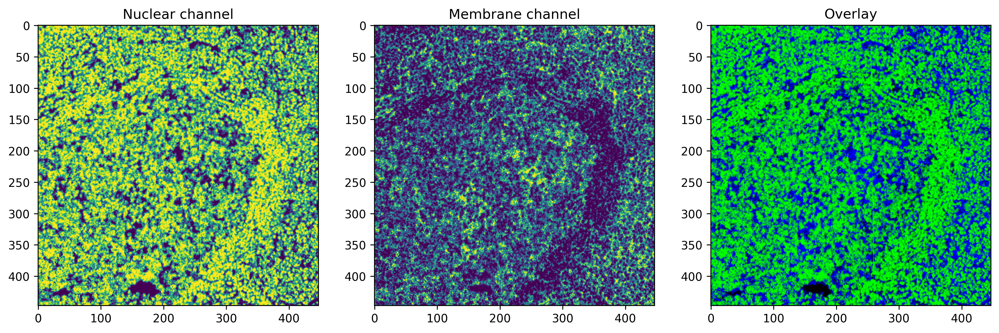

In [199]:
idx = 0 

fig, ax = plt.subplots(1, 3, figsize=(15, 15))
ax[0].imshow(X_train[idx, ..., 0])
ax[1].imshow(X_train[idx, ..., 1])
ax[2].imshow(rgb_images[idx, ...])

ax[0].set_title('Nuclear channel')
ax[1].set_title('Membrane channel')
ax[2].set_title('Overlay')

plt.show()

In [200]:

X_trains = []
for i, img_dapi in enumerate(imgs_dapi):
    img_cyto = np.stack(imgs_cropped[i])[indices]
    img_cyto = np.max(img_cyto, axis=0)
    img_cyto = cv2.subtract(img_cyto, img_dapi)
    
    X_trains.append(np.stack([img_dapi, img_cyto], axis=-1))



In [201]:
idx = 4
# X_train = np.stack(X_trains)
X_train = X_trains[idx][np.newaxis, ...]
rgb_images = make_color_overlay(X_train)

In [85]:
segmentation_predictions = app.predict(X_train, image_mpp=1, compartment='both', postprocess_kwargs_whole_cell=postprocess_kwargs_cell, postprocess_kwargs_nuclear=postprocess_kwargs_nuclei)

In [86]:
overlay_data = make_outline_overlay(rgb_data=rgb_images, predictions=segmentation_predictions[...,:1])
overlay_data_nuc = make_outline_overlay(rgb_data=rgb_images, predictions=segmentation_predictions[...,1:])


In [87]:
# new_segmentation_path = data_dir / 'mask_mesmer'

# file_path = new_segmentation_path / f'{datasets[idx]}.png'
# io.imsave(file_path, segmentation_predictions[0,...,0])

# file_path = new_segmentation_path / f'{datasets[idx]}_nuclei.png'
# io.imsave(file_path, segmentation_predictions[0,...,1])

In [88]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

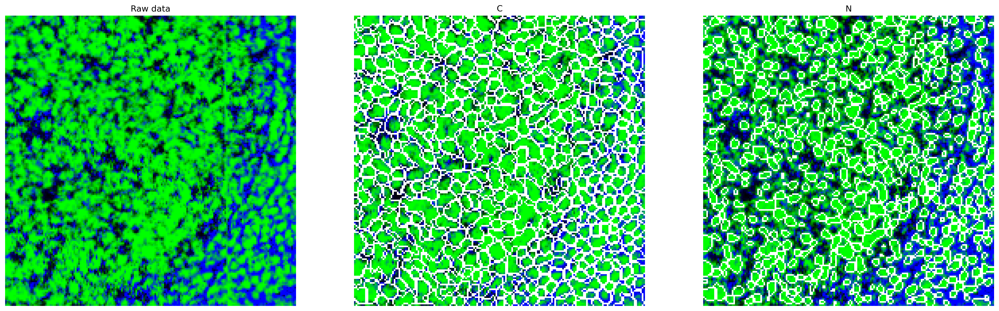

In [89]:
fig, ax = plt.subplots(1, 3, figsize=(25, 15))
ax[0].imshow(rgb_images[0, 200:400, 200:400, :])
ax[1].imshow(overlay_data[0, 200:400, 200:400,...], cmap='gray')
ax[2].imshow(overlay_data_nuc[0, 200:400, 200:400,...], cmap='gray')
ax[0].set_title('Raw data')
ax[1].set_title('C')
ax[2].set_title('N')
for a in ax:
    a.axis('off')
plt.show()

# Segmentation SIMS channel only 

In [205]:
imgs_sims = []

for i, dataset in enumerate(datasets):
    try:
        info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
    except:
        continue
    imgs, labels = get_imgs_sims(experiment, dataset)
    # Read nulcie channel
    img_nuclei_downscale = get_imgs_index(
        imgs, [18, 32], fov_dim=imgs_dapi[i].shape[0]
    )
    # Contrast streching
    p2, p98 = np.percentile(img_nuclei_downscale, (20, 99))
    img_nuclei_downscale = exposure.rescale_intensity(
        img_nuclei_downscale, in_range=(p2, p98), out_range=(0, 100)
    )    
    img_nuclei_downscale = img_nuclei_downscale.astype(np.uint8)

    imgs_sims.append(img_nuclei_downscale)

In [149]:
idx = 4
img = imgs_sims[idx]
# X_train = np.stack(X_trains)
X_train = np.stack([img], axis=-1)[np.newaxis,...]
rgb_images = make_color_overlay(X_train)
X_train = np.stack([img, np.full_like(img, 0)], axis=-1)[np.newaxis,...]

In [291]:
segmentation_predictions = app.predict(X_train, image_mpp=1, compartment='nuclear', postprocess_kwargs_whole_cell=postprocess_kwargs_cell, postprocess_kwargs_nuclear=postprocess_kwargs_nuclei)

In [292]:
overlay_data = make_outline_overlay(rgb_data=rgb_images, predictions=segmentation_predictions[...,:1])


In [293]:
new_segmentation_path = data_dir / 'mask_mesmer'

file_path = new_segmentation_path / f'{datasets[idx]}_nuclei_sims.png'
io.imsave(file_path, segmentation_predictions[0,...,0])

C:\Users\thu71\Anaconda3\envs\snowflakes\lib\site-packages\ipykernel_launcher.py:4: UserWarning: \\bme-retromaster.ad.gatech.edu\labs5\coskun-lab\Thomas\ScSpaMet\data\mask_mesmer\DonorA_5_nuclei_sims.png is a low contrast image
  after removing the cwd from sys.path.


In [294]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

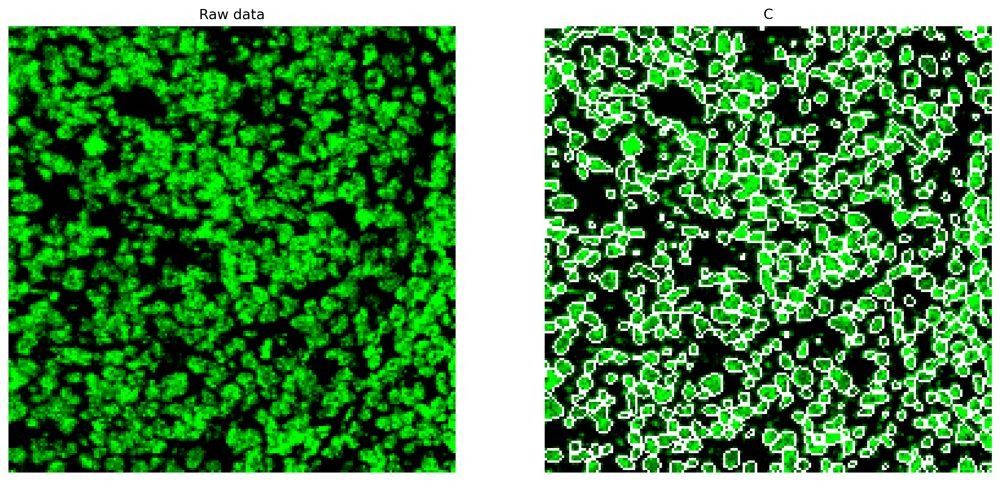

In [295]:
fig, ax = plt.subplots(1, 2, figsize=(15, 15))
ax[0].imshow(rgb_images[0, 200:400, 200:400, :])
ax[1].imshow(overlay_data[0, 200:400, 200:400,...], cmap='gray')
ax[0].set_title('Raw data')
ax[1].set_title('C')
for a in ax:
    a.axis('off')
plt.show()

# Comparison of nuclei vs cytosolic segmentation

In [210]:
# Read files in folder 
from collections import defaultdict
from skimage import measure

new_segmentation_path = data_dir / 'mask_mesmer'


masks_path = defaultdict(dict) 
for path in os.listdir(new_segmentation_path):
    name = path.split('.')[0]
    if core in name:
        if 'sims' in name:
            masks_path[name[:8]]['Nuclei SIMS'] =  path
        elif 'nuclei' in name:
            masks_path[name[:8]]['Nuclei'] = path
        elif '.png' in path:
            masks_path[name[:8]]['Cell'] = path    


In [211]:
from skimage.segmentation import find_boundaries

def make_outline_overlay(rgb_data, predictions):
    """Overlay a segmentation mask with image data for easy visualization

    Args:
        rgb_data: 3 channel array of images, output of ``create_rgb_data``
        predictions: segmentation predictions to be visualized

    Returns:
        numpy.array: overlay image of input data and predictions

    Raises:
        ValueError: If predictions are not 4D
        ValueError: If there is not matching RGB data for each prediction
    """
    if len(predictions.shape) != 4:
        raise ValueError(f'Predictions must be 4D, got {predictions.shape}')

    if predictions.shape[0] > rgb_data.shape[0]:
        raise ValueError('Must supply an rgb image for each prediction')

    boundaries = np.zeros_like(rgb_data)
    overlay_data = np.copy(rgb_data)

    for img in range(predictions.shape[0])[:1]:
        boundary = find_boundaries(predictions[img, ..., 0], connectivity=1, mode='thick')
        boundaries[img, boundary > 0, :] = 1

    overlay_data[boundaries > 0] = 1
    boundaries[..., 0] = 0
    overlay_data[boundaries > 0] = 0
    return overlay_data, boundaries

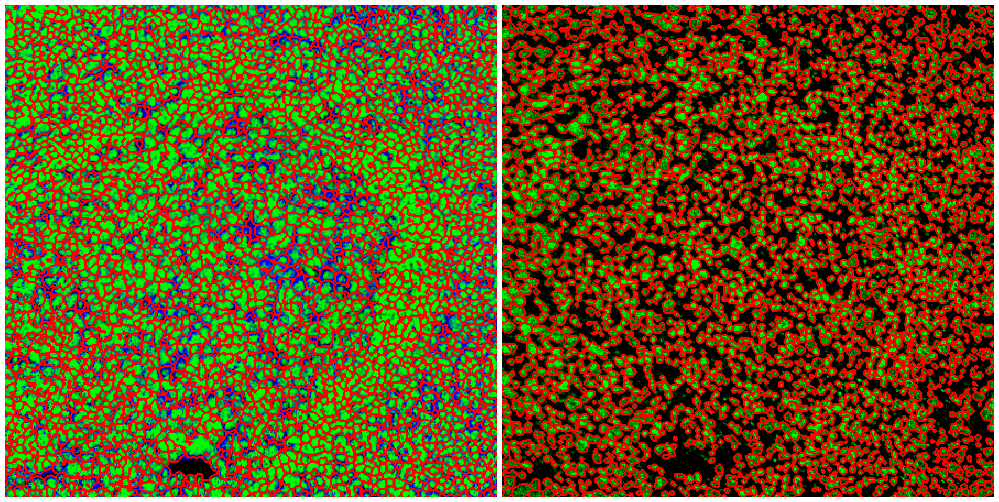

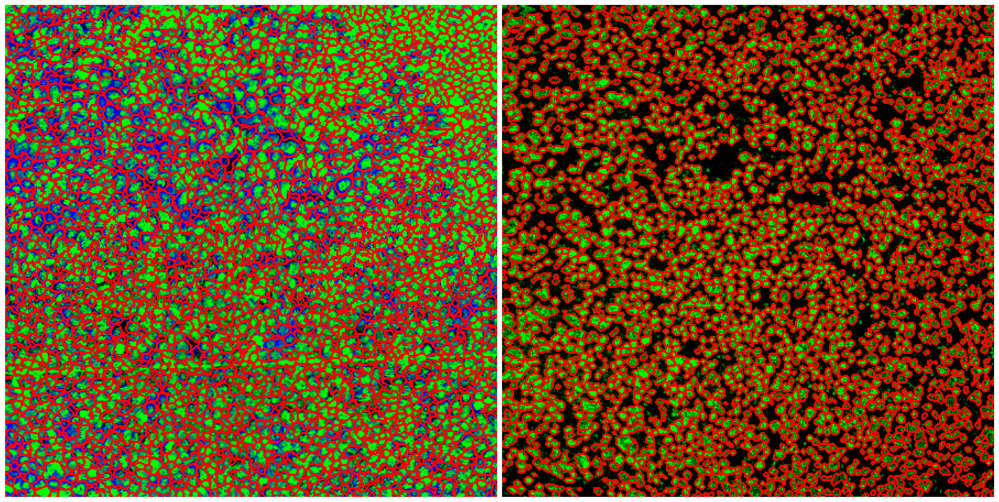

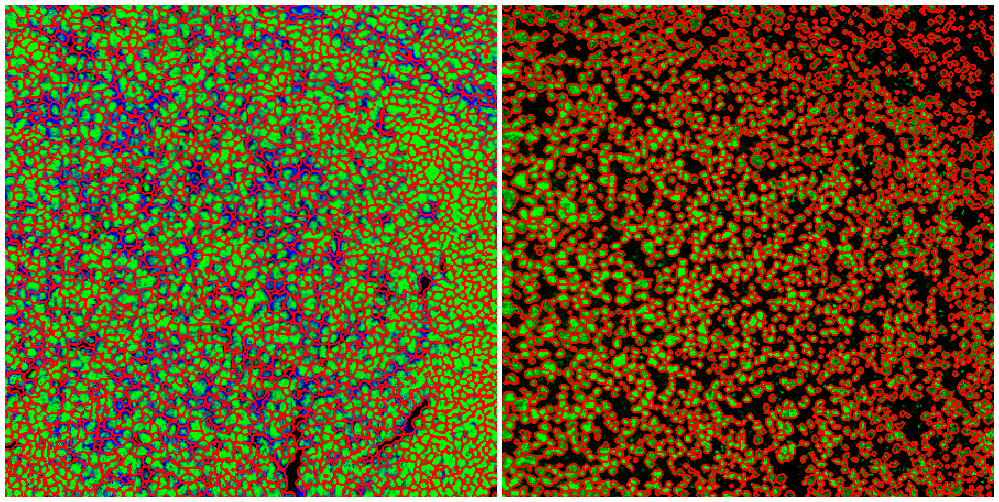

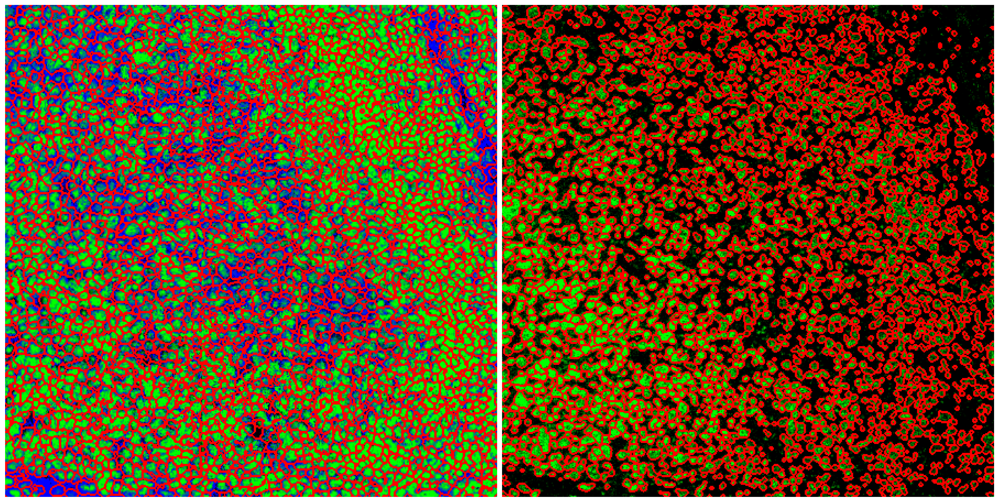

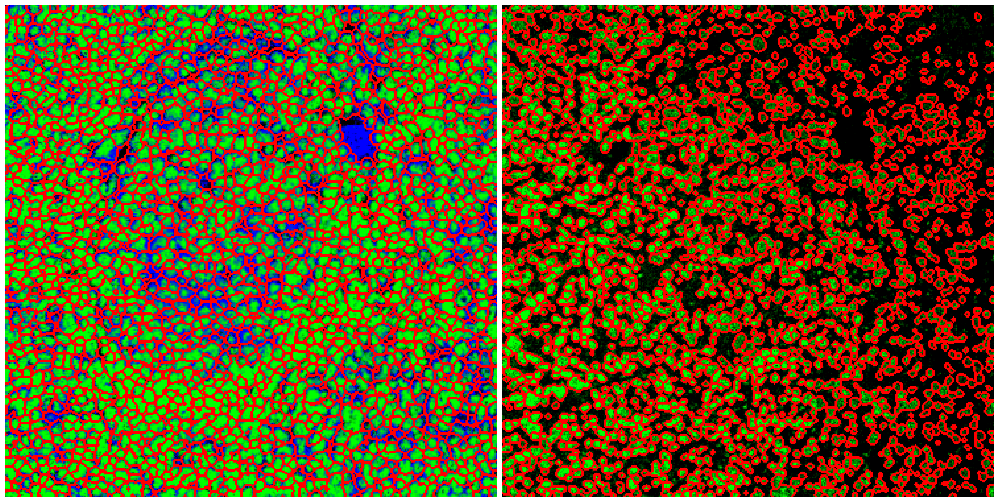

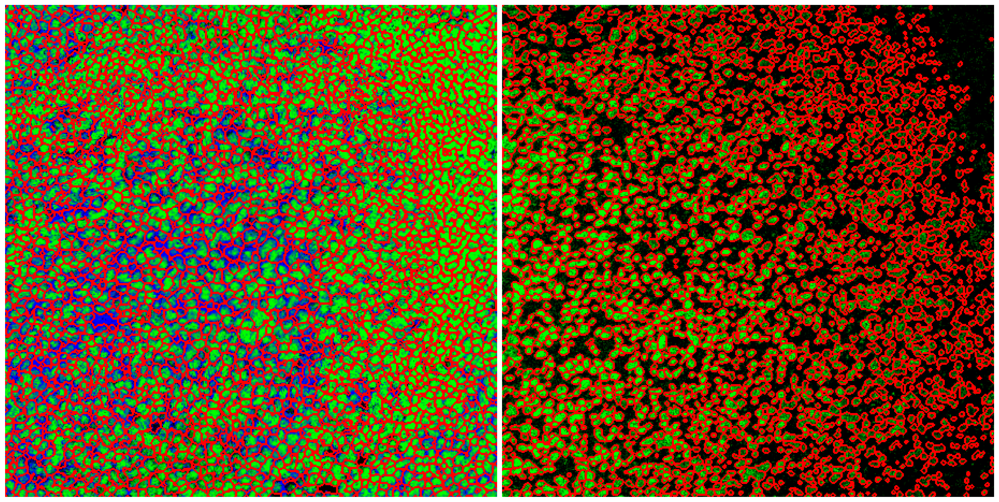

In [212]:
# Extract cell and nuclei size 
for idx, (k, v) in enumerate(masks_path.items()):   
    X_train = X_trains[idx][np.newaxis, ...]
    rgb_images = make_color_overlay(X_train)
    
    img = imgs_sims[idx]
    X_train_sims = np.stack([img], axis=-1)[np.newaxis,...]
    rgb_images_sims = make_color_overlay(X_train_sims)

    mask_cell = skimage.io.imread(new_segmentation_path / v['Cell'])
    mask_sims = skimage.io.imread(new_segmentation_path / v['Nuclei SIMS'])
    overlay_data, boundaries = make_outline_overlay(rgb_data=rgb_images,
                                        predictions=mask_cell[np.newaxis,...,np.newaxis])
    overlay_data_nuc, _ = make_outline_overlay(rgb_data=rgb_images_sims,
                                        predictions=mask_sims[np.newaxis,...,np.newaxis])
    
    fig, ax = plt.subplots(1, 2, figsize=(25, 15))
    ax[0].imshow(overlay_data[0], cmap='gray')
    ax[1].imshow(overlay_data_nuc[0], cmap='gray')
    for a in ax:
        a.axis('off')
    fig.subplots_adjust(wspace=0.01)
    plt.show()
    


In [128]:
# Extract cell and nuclei size 

dfs = []

for k, v in masks_path.items():    
    for t in ['Cell', 'Nuclei', 'Nuclei SIMS']:
        mask_cell = skimage.io.imread(new_segmentation_path / v[t])

        df_region = pd.DataFrame(measure.regionprops_table(mask_cell, properties=('label', 'area')))
        df_region['Type'] =t
        dfs.append(df_region)

In [23]:
df = pd.concat(dfs)

In [24]:
df.to_clipboard()

In [11]:
from statannotations.Annotator import Annotator
import itertools

def plot(plotting):
    pairs = list(itertools.combinations(['Cell', 'Nuclei', 'Nuclei SIMS'], 2))

    with sns.plotting_context('talk', font_scale=1):
        fig, ax = plt.subplots(figsize=(7,4))
        ax = sns.boxplot(**plotting, showfliers=False, ax=ax)
        annot = Annotator(ax, pairs, **plotting)
        annot.configure(test='Mann-Whitney', text_format='star', loc='outside', verbose=0)
        result = annot.apply_test().annotate()
        plt.xticks(rotation=30, ha='right')
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


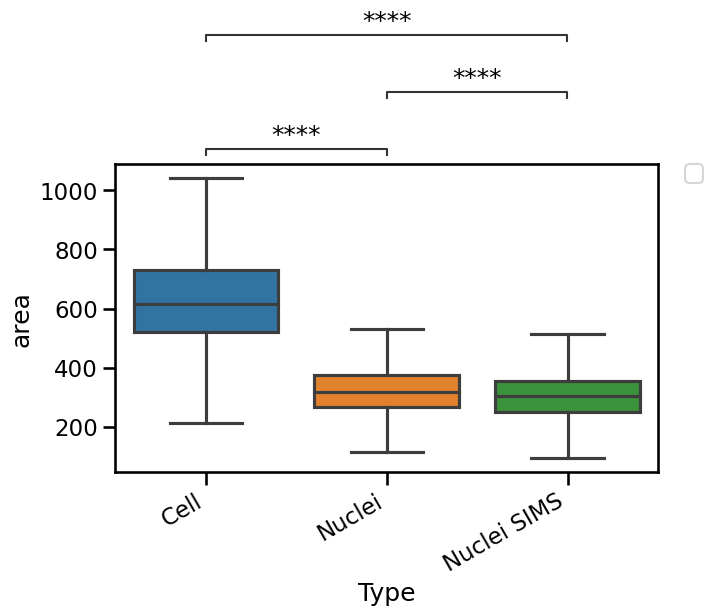

In [14]:
# Plot comparison of cell and nuclei size
import seaborn as sns 
    
plotting = {
            "data": df,
            "x": "Type",
            "y": "area",
        }


with sns.plotting_context('notebook', font_scale=1.4):
    plot(plotting)